# **Новый датасет**

Я нашёл датасет на 70000 лиц (https://www.kaggle.com/datasets/melikbekyanashot/faces-dataset) и попробую обучить ту же нейросеть на нём. Проделаем то же самое и посмотрим на результаты.

In [ ]:
import os
from torch.utils.data import DataLoader
from torchvision.datasets import ImageFolder
import torchvision.transforms as tt
import torch
import torch.nn as nn
import cv2
from tqdm.notebook import tqdm
from torchvision.utils import save_image
from torchvision.utils import make_grid
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

sns.set(style='darkgrid', font_scale=1.2)

## 1. Подготовка данных

In [11]:
DATA_DIR = '/kaggle/input/faces-dataset'

def get_dataloader(image_size, batch_size):
  """
  Builds dataloader for training data.
  Use tt.Compose and tt.Resize for transformations
  :param image_size: height and wdith of the image
  :param batch_size: batch_size of the dataloader
  :returns: DataLoader object 
  """
  transform = tt.Compose([tt.Resize(image_size),
                          tt.ToTensor(),
                          tt.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])
  dataset = ImageFolder(DATA_DIR, transform)
  dataloader = DataLoader(dataset, batch_size, shuffle=True, num_workers=2, pin_memory=True)
  return dataloader


image_size = 64
batch_size = 128

dataloader = get_dataloader(image_size, batch_size)

device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

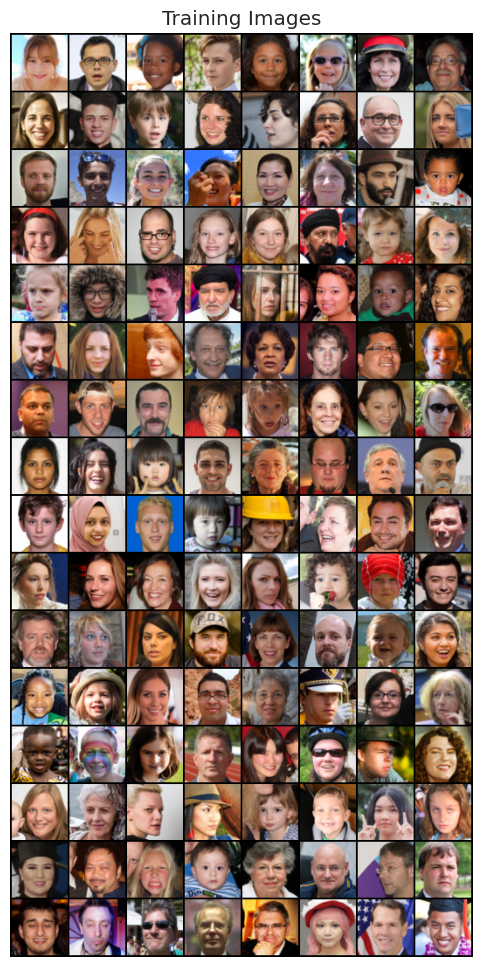

In [12]:
batch, _ = next(iter(dataloader))

plt.figure(figsize=(12, 12))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(make_grid(batch.to(device), padding=2, normalize=True).cpu() ,(1,2,0)))

## 2. Обучение модели

In [ ]:
latent_size = 128
features = 64

In [ ]:
discriminator = nn.Sequential(
    nn.Conv2d(3, features, 4, 2, 1, bias=False),
    nn.BatchNorm2d(features),
    nn.LeakyReLU(0.2, inplace=True),
    
    nn.Conv2d(features, features*2, 4, 2, 1, bias=False),
    nn.BatchNorm2d(features*2),
    nn.LeakyReLU(0.2, inplace=True),
    
    nn.Conv2d(features*2, features*4, 4, 2, 1, bias=False),
    nn.BatchNorm2d(features*4),
    nn.LeakyReLU(0.2, inplace=True),
    
    nn.Conv2d(features*4, features*8, 4, 2, 1, bias=False),
    nn.BatchNorm2d(features*8),
    nn.LeakyReLU(0.2, inplace=True),
    
    nn.Conv2d(features*8, 1, 4, 1, 0, bias=False),
    nn.Flatten(),
    nn.Sigmoid()
)

In [ ]:
generator = nn.Sequential(
    nn.ConvTranspose2d(latent_size, features*16, 4, 1, 1, bias=False),
    nn.BatchNorm2d(features*16),
    nn.ReLU(True),
    
    nn.ConvTranspose2d(features*16, features*8, 4, 2, 1, bias=False),
    nn.BatchNorm2d(features*8),
    nn.ReLU(True),
    
    nn.ConvTranspose2d(features*8, features*4, 4, 2, 1, bias=False),
    nn.BatchNorm2d(features*4),
    nn.ReLU(True),
    
    nn.ConvTranspose2d(features*4, features*2, 4, 2, 1, bias=False),
    nn.BatchNorm2d(features*2),
    nn.ReLU(True),
    
    nn.ConvTranspose2d(features*2, features, 4, 2, 1, bias=False),
    nn.BatchNorm2d(features),
    nn.ReLU(True),
    
    nn.ConvTranspose2d(features, 3, 4, 2, 1, bias=False),
    nn.Tanh()
)

In [ ]:
# инициализация весов
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [15]:
lr = 0.001

discriminator.apply(weights_init)
generator.apply(weights_init)

model = {
    "discriminator": discriminator,
    "generator": generator
}

criterion = {
    "discriminator": nn.BCELoss(),
    "generator": nn.BCELoss()
}

In [ ]:
def fit(model, criterion, epochs, lr, start_idx=1):
    model["discriminator"].to(device)
    model["generator"].to(device)
    model["discriminator"].train()
    model["generator"].train()
    torch.cuda.empty_cache()
    
    losses_g = []
    losses_d = []
    real_scores = []
    fake_scores = []
    
    optimizer = {
        "discriminator": torch.optim.Adam(model["discriminator"].parameters(), 
                                          lr=lr, betas=(0.5, 0.999)),
        "generator": torch.optim.Adam(model["generator"].parameters(),
                                      lr=lr, betas=(0.5, 0.999))
    }
    
    for epoch in tqdm(range(epochs)):


        loss_d_per_epoch = []
        loss_g_per_epoch = []
        real_score_per_epoch = []
        fake_score_per_epoch = []
        for real_images, _ in dataloader:
            # Обучение дискриминатора
            real_images = real_images.to(device)
            optimizer["discriminator"].zero_grad()

            # Передаем реальные изображения дискриминатору
            real_preds = model["discriminator"](real_images)
            real_targets = torch.FloatTensor(real_images.size(0), 1).uniform_(0.95, 1.0).to(device)
            real_loss = criterion["discriminator"](real_preds, real_targets)
            cur_real_score = torch.mean(real_preds).item()
            
            # Генерируем изображений
            latent = torch.randn(real_images.size(0), latent_size, 1, 1, device=device)
            fake_images = model["generator"](latent)

            # Передаем сгенерированные изображения дискриминатору
            fake_targets = torch.FloatTensor(fake_images.size(0), 1).uniform_(0.0, 0.05).to(device)
            fake_preds = model["discriminator"](fake_images)
            fake_loss = criterion["discriminator"](fake_preds, fake_targets)
            cur_fake_score = torch.mean(fake_preds).item()

            real_score_per_epoch.append(cur_real_score)
            fake_score_per_epoch.append(cur_fake_score)

            # Обновляем веса
            loss_d = real_loss + fake_loss
            loss_d.backward()
            optimizer["discriminator"].step()
            loss_d_per_epoch.append(loss_d.item())


            # Обучаем генератор
            optimizer["generator"].zero_grad()
            
            # Генерируем изображения
            latent = torch.randn(real_images.size(0), latent_size, 1, 1, device=device)
            fake_images = model["generator"](latent)
            
            # Передаем сгенерированные изображения дискриминатору
            preds = model["discriminator"](fake_images)
            targets = torch.FloatTensor(real_images.size(0), 1).uniform_(0.95, 1.0).to(device)
            loss_g = criterion["generator"](preds, targets)
            
            # Обновляем веса
            loss_g.backward()
            optimizer["generator"].step()
            loss_g_per_epoch.append(loss_g.item())
            
        # Запись в историю
        losses_g.append(np.mean(loss_g_per_epoch))
        losses_d.append(np.mean(loss_d_per_epoch))
        real_scores.append(np.mean(real_score_per_epoch))
        fake_scores.append(np.mean(fake_score_per_epoch))
        
        # Логирование
        print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_score: {:.4f}, fake_score: {:.4f}".format(
            epoch+1, epochs, 
            losses_g[-1], losses_d[-1], real_scores[-1], fake_scores[-1]))

        # Пример генерации
        plt.figure(figsize=(12,12))
        plt.axis("off")
        plt.title("Generated Images")
        plt.imshow(np.transpose(make_grid(fake_images.to(device)[:16], padding=2, normalize=True).cpu(),(1,2,0)))
        plt.show()
    
    return losses_g, losses_d, real_scores, fake_scores

  0%|          | 0/25 [00:00<?, ?it/s]

Epoch [1/25], loss_g: 5.0600, loss_d: 1.7956, real_score: 0.7276, fake_score: 0.2960


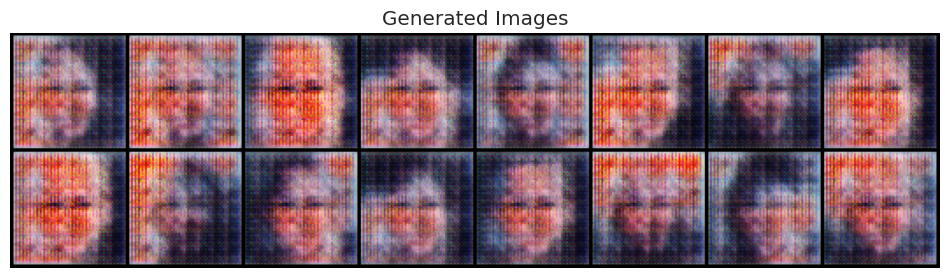

Epoch [2/25], loss_g: 3.4014, loss_d: 1.2001, real_score: 0.6651, fake_score: 0.3349


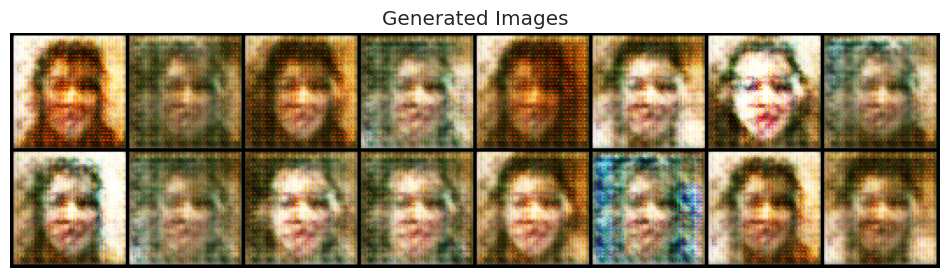

Epoch [3/25], loss_g: 3.2651, loss_d: 1.1350, real_score: 0.6707, fake_score: 0.3304


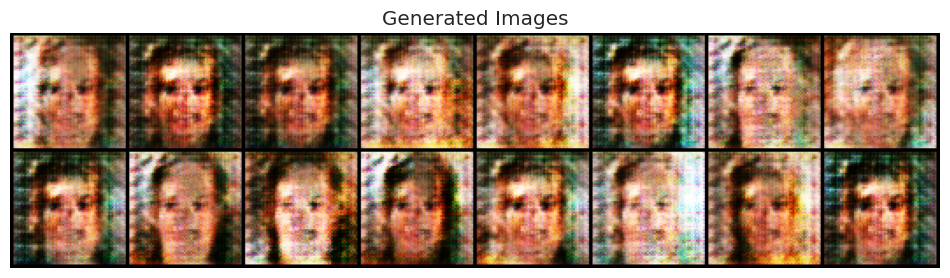

Epoch [4/25], loss_g: 3.1724, loss_d: 1.0887, real_score: 0.6714, fake_score: 0.3266


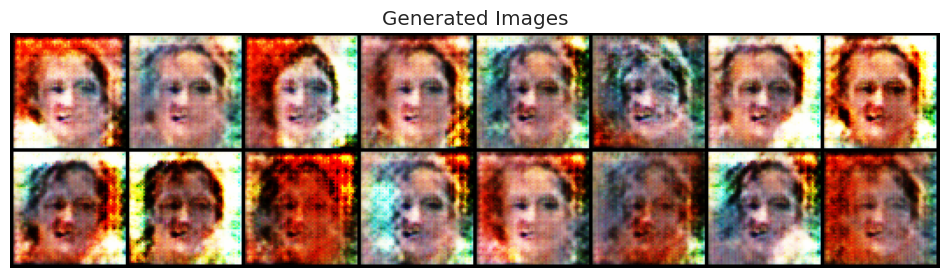

Epoch [5/25], loss_g: 3.0925, loss_d: 1.0386, real_score: 0.6854, fake_score: 0.3125


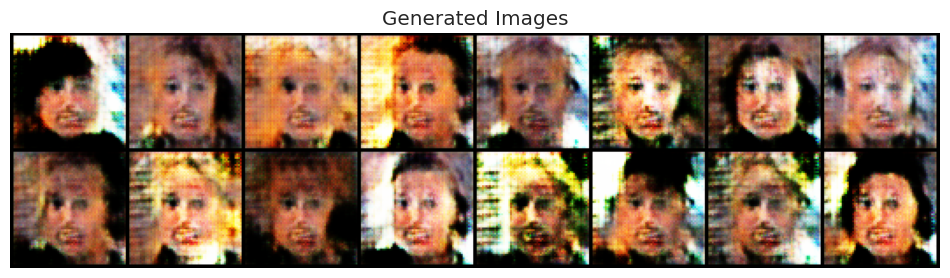

Epoch [6/25], loss_g: 2.9621, loss_d: 1.0128, real_score: 0.6899, fake_score: 0.3077


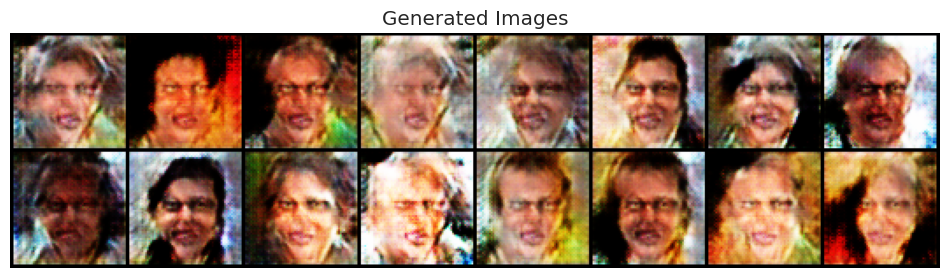

Epoch [7/25], loss_g: 3.0675, loss_d: 0.9820, real_score: 0.7021, fake_score: 0.2954


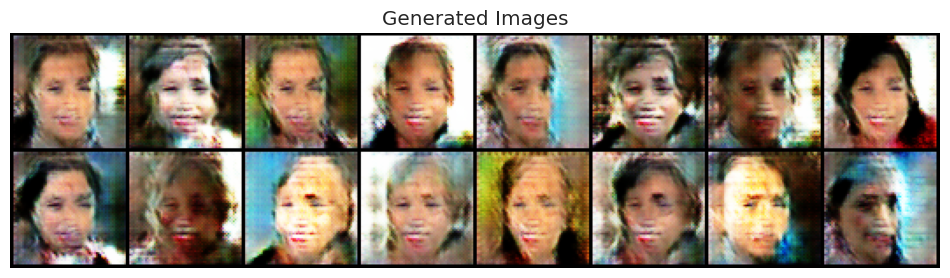

Epoch [8/25], loss_g: 3.0539, loss_d: 0.9816, real_score: 0.7025, fake_score: 0.2966


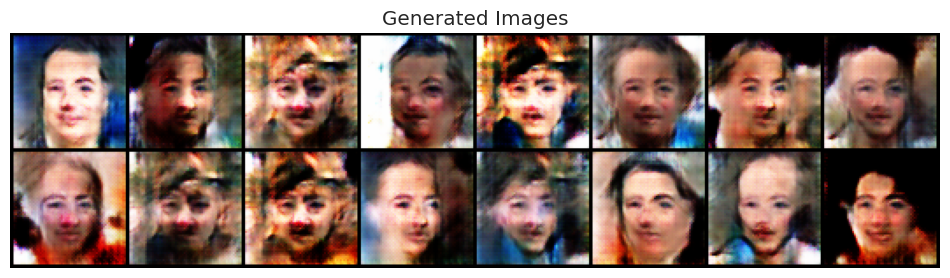

Epoch [9/25], loss_g: 3.0720, loss_d: 0.9433, real_score: 0.7128, fake_score: 0.2858


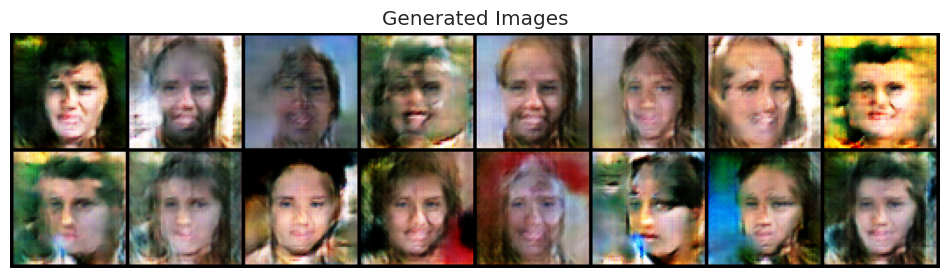

Epoch [10/25], loss_g: 3.1352, loss_d: 0.9137, real_score: 0.7221, fake_score: 0.2768


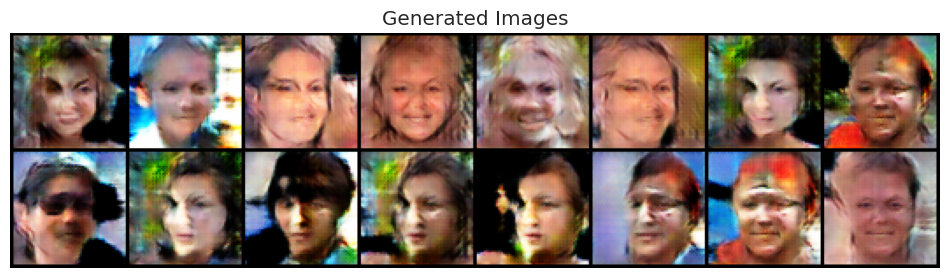

Epoch [11/25], loss_g: 3.0289, loss_d: 0.8977, real_score: 0.7310, fake_score: 0.2683


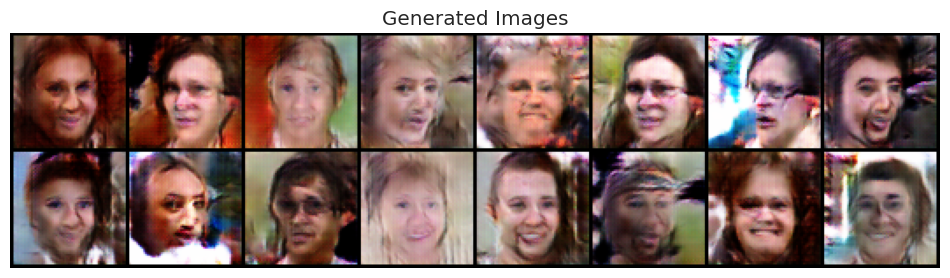

Epoch [12/25], loss_g: 2.9881, loss_d: 0.8748, real_score: 0.7362, fake_score: 0.2630


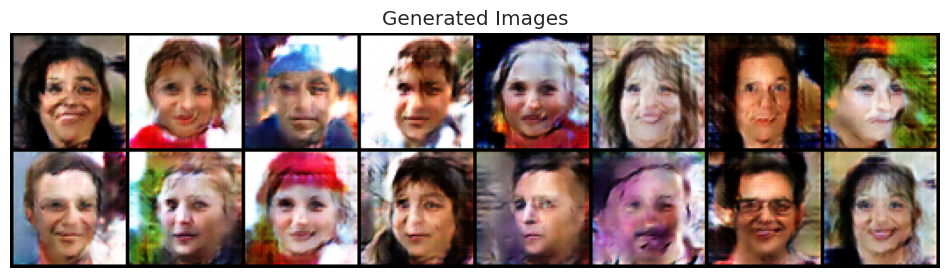

Epoch [13/25], loss_g: 2.9719, loss_d: 0.8794, real_score: 0.7390, fake_score: 0.2606


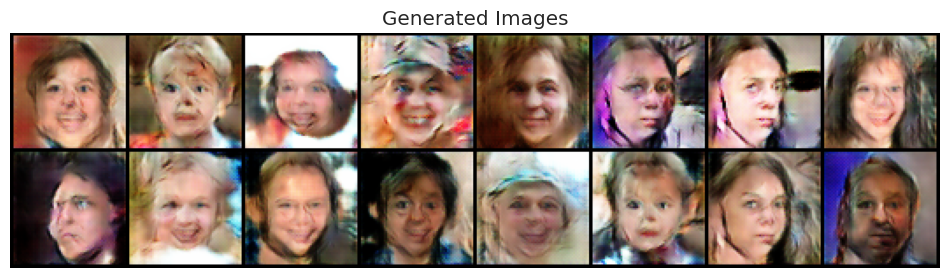

Epoch [14/25], loss_g: 2.8947, loss_d: 0.8475, real_score: 0.7461, fake_score: 0.2531


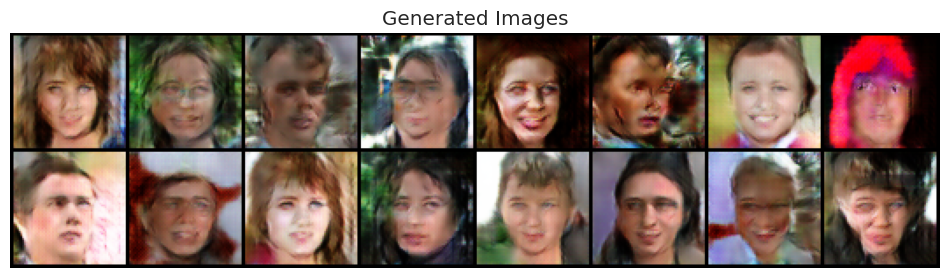

Epoch [15/25], loss_g: 2.7947, loss_d: 0.8295, real_score: 0.7504, fake_score: 0.2487


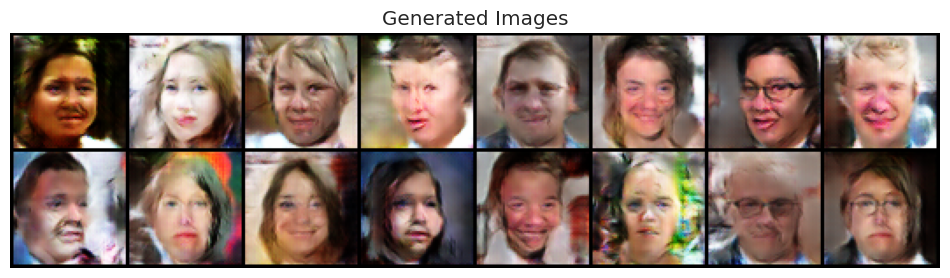

Epoch [16/25], loss_g: 2.8140, loss_d: 0.8324, real_score: 0.7526, fake_score: 0.2469


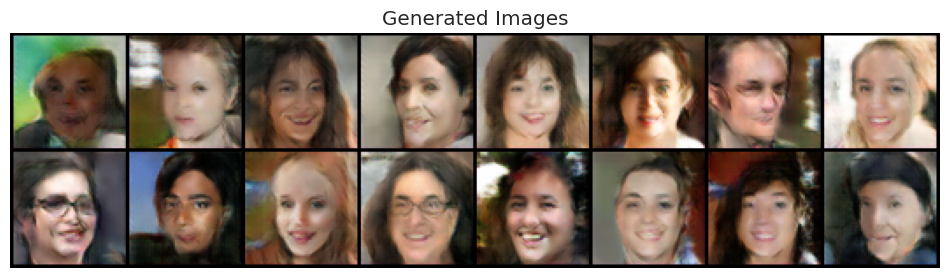

Epoch [17/25], loss_g: 2.7990, loss_d: 0.8227, real_score: 0.7539, fake_score: 0.2458


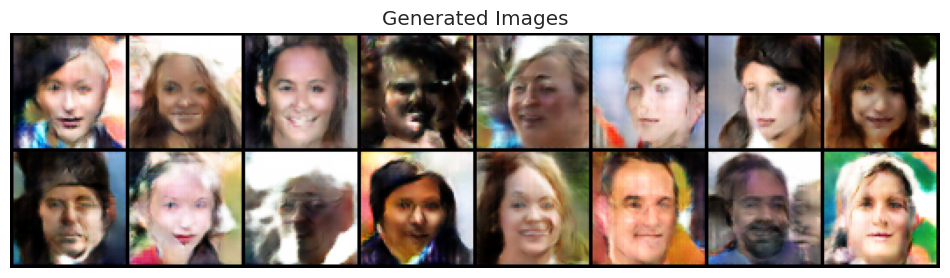

Epoch [18/25], loss_g: 2.7350, loss_d: 0.8134, real_score: 0.7575, fake_score: 0.2414


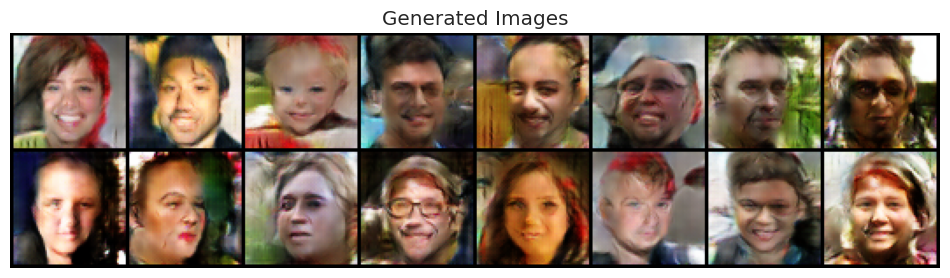

Epoch [19/25], loss_g: 2.7517, loss_d: 0.7949, real_score: 0.7637, fake_score: 0.2362


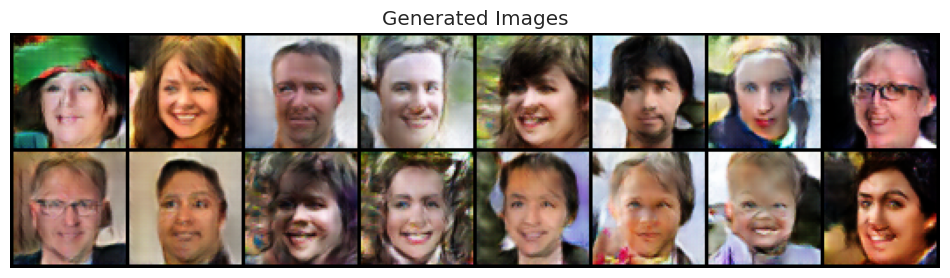

Epoch [20/25], loss_g: 2.6835, loss_d: 0.7983, real_score: 0.7643, fake_score: 0.2354


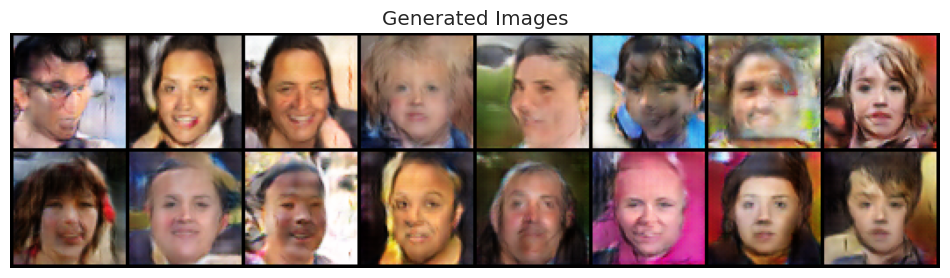

Epoch [21/25], loss_g: 2.6880, loss_d: 0.7802, real_score: 0.7706, fake_score: 0.2287


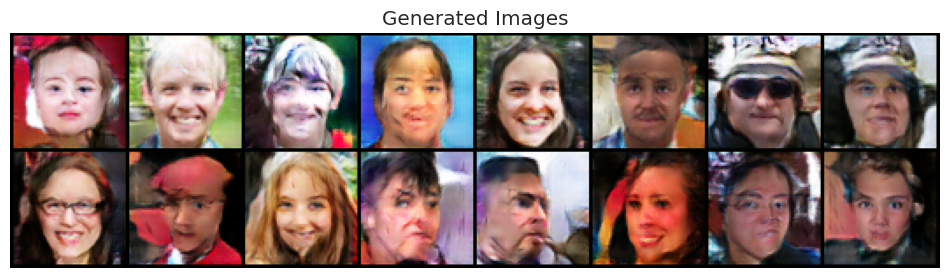

Epoch [22/25], loss_g: 2.7344, loss_d: 0.7590, real_score: 0.7767, fake_score: 0.2228


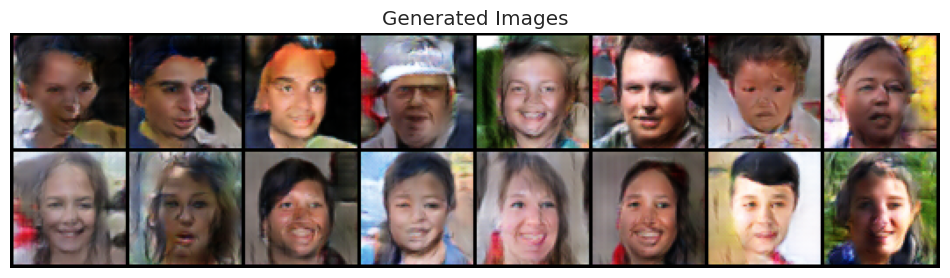

Epoch [23/25], loss_g: 2.7413, loss_d: 0.7536, real_score: 0.7785, fake_score: 0.2209


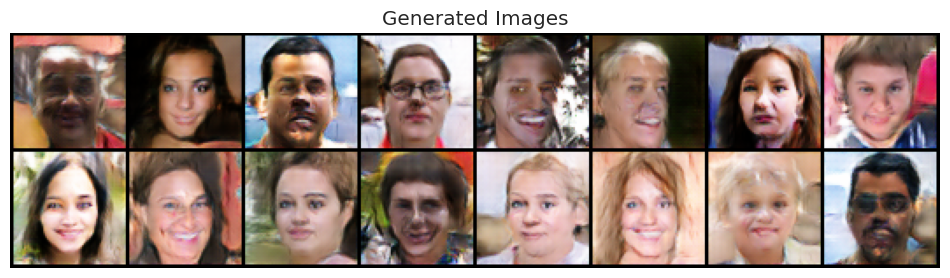

Epoch [24/25], loss_g: 2.7841, loss_d: 0.7324, real_score: 0.7867, fake_score: 0.2130


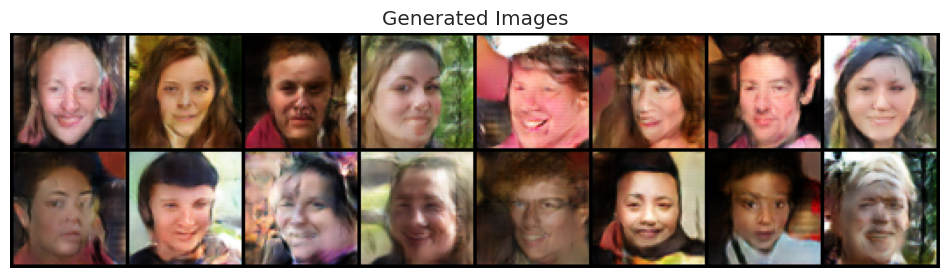

Epoch [25/25], loss_g: 2.8216, loss_d: 0.7414, real_score: 0.7881, fake_score: 0.2113


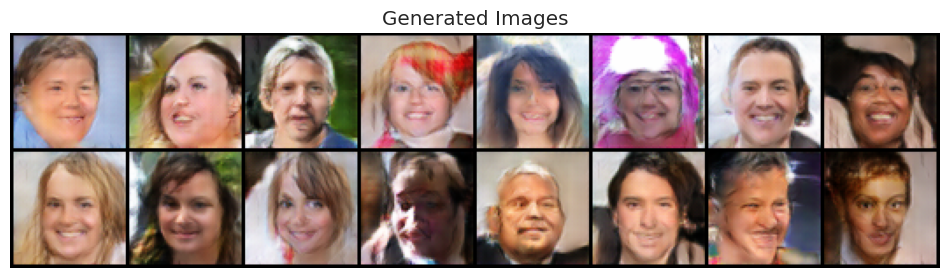

In [16]:
losses_g, losses_d, real_scores, fake_scores = fit(model, criterion, 25, lr)

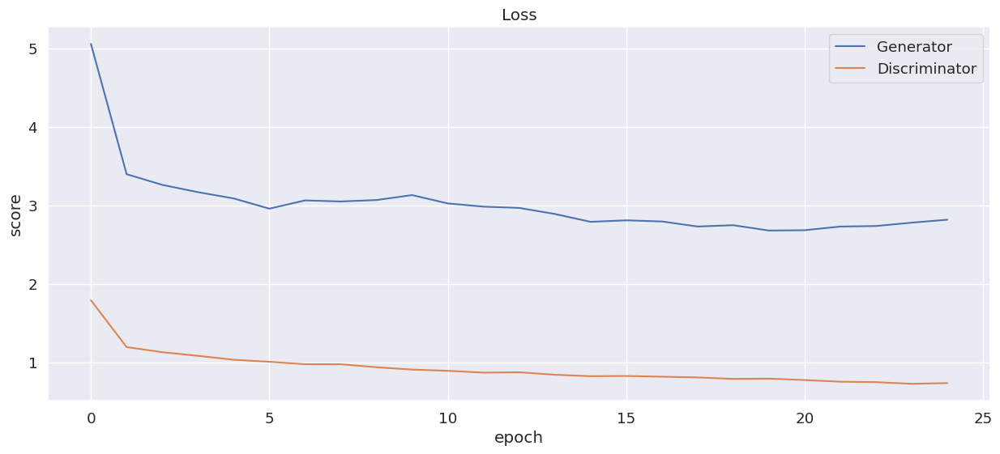

In [17]:
plt.figure(figsize=(15, 6))

plt.plot(losses_g, '-')
plt.plot(losses_d, '-')
plt.xlabel('epoch')
plt.ylabel('score')
plt.legend(['Generator', 'Discriminator'])
plt.title('Loss');

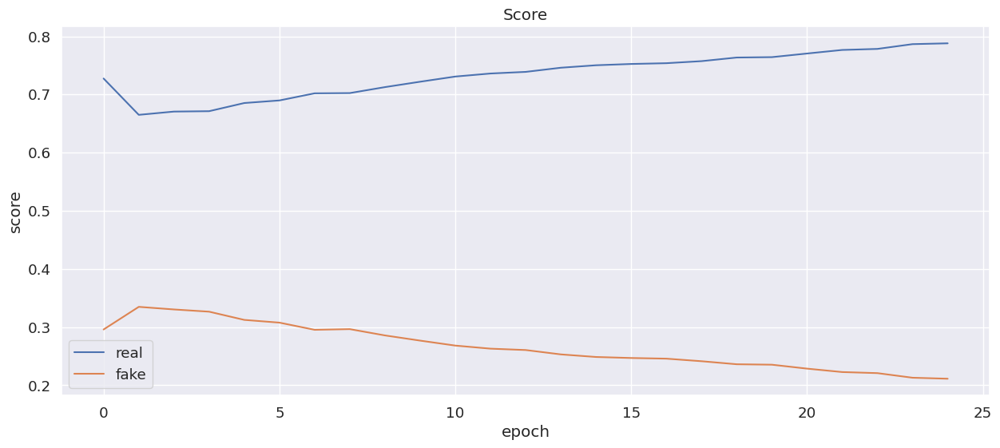

In [18]:
plt.figure(figsize=(15, 6))

plt.plot(real_scores, '-')
plt.plot(fake_scores, '-')
plt.xlabel('epoch')
plt.ylabel('score')
plt.legend(['real', 'fake'])
plt.title('Score');

  0%|          | 0/25 [00:00<?, ?it/s]

Epoch [1/25], loss_g: 2.6858, loss_d: 0.4966, real_score: 0.8567, fake_score: 0.1425


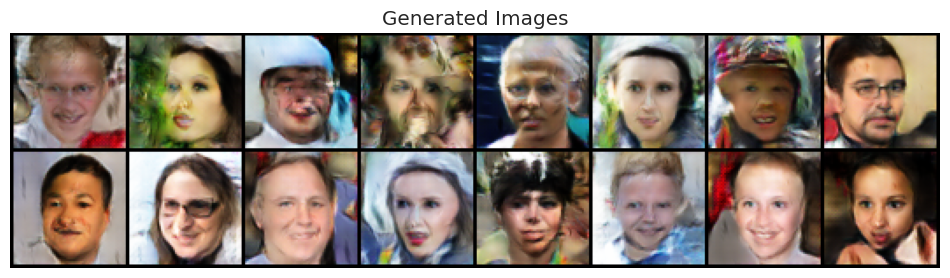

Epoch [2/25], loss_g: 2.8276, loss_d: 0.5197, real_score: 0.8576, fake_score: 0.1419


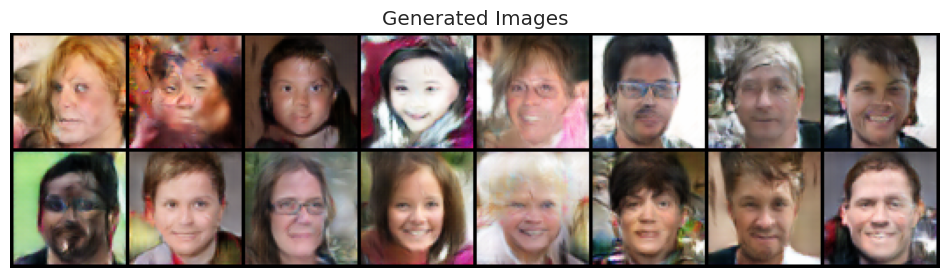

Epoch [3/25], loss_g: 2.8475, loss_d: 0.4822, real_score: 0.8635, fake_score: 0.1356


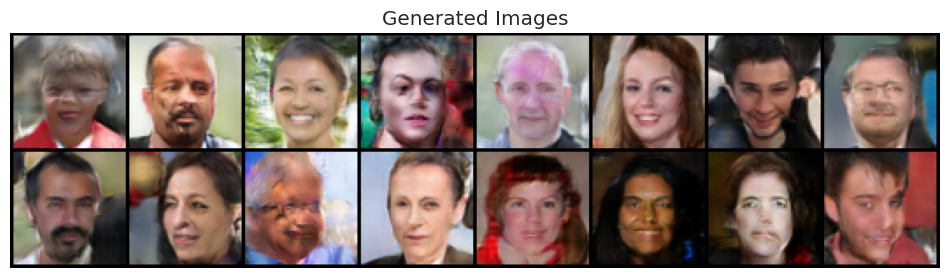

Epoch [4/25], loss_g: 2.8978, loss_d: 0.5297, real_score: 0.8588, fake_score: 0.1409


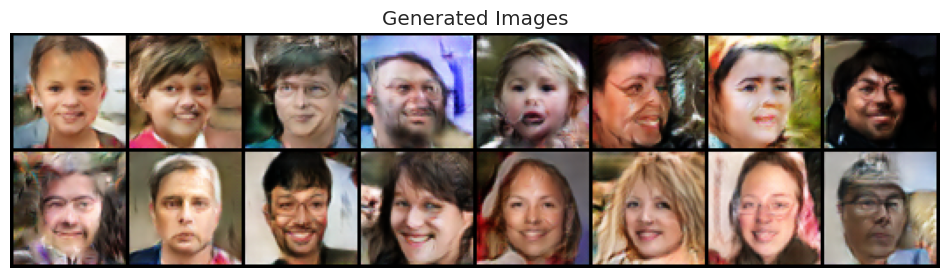

Epoch [5/25], loss_g: 2.9157, loss_d: 0.5128, real_score: 0.8615, fake_score: 0.1384


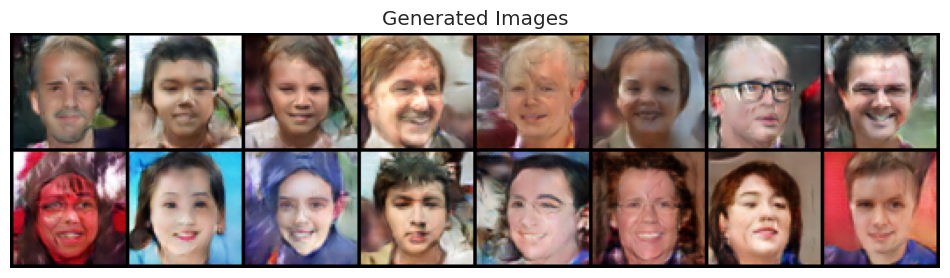

Epoch [6/25], loss_g: 2.9727, loss_d: 0.5222, real_score: 0.8605, fake_score: 0.1395


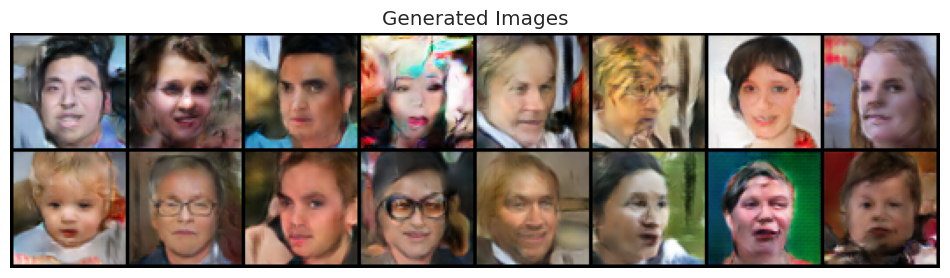

Epoch [7/25], loss_g: 3.0252, loss_d: 0.4879, real_score: 0.8690, fake_score: 0.1304


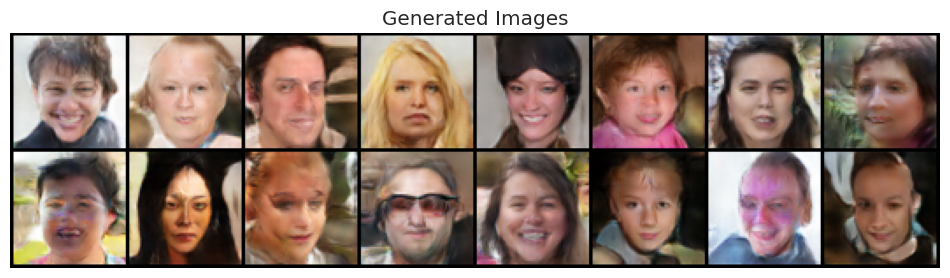

Epoch [8/25], loss_g: 3.1225, loss_d: 0.5000, real_score: 0.8702, fake_score: 0.1298


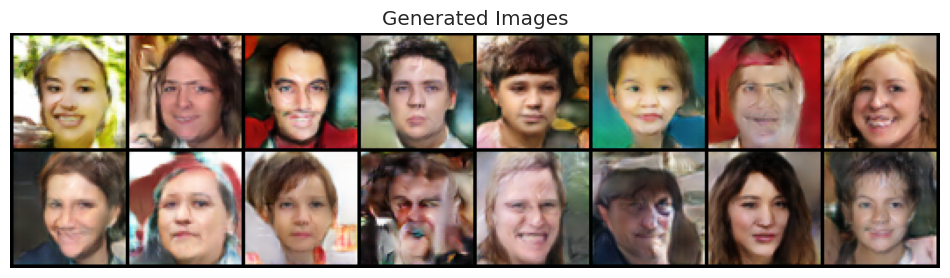

Epoch [9/25], loss_g: 3.1002, loss_d: 0.5054, real_score: 0.8693, fake_score: 0.1304


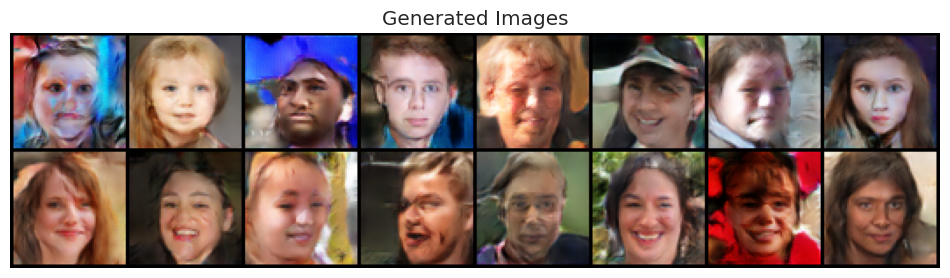

Epoch [10/25], loss_g: 3.1891, loss_d: 0.4900, real_score: 0.8739, fake_score: 0.1263


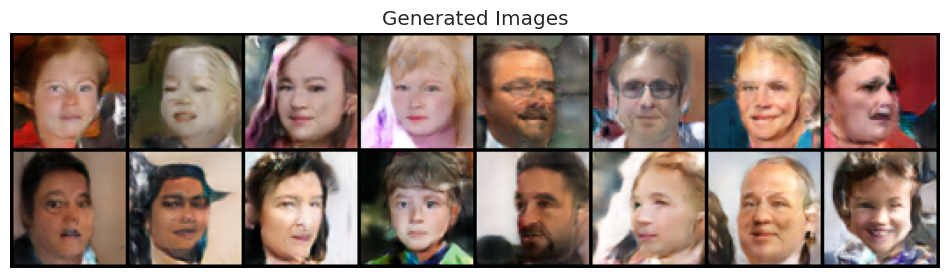

Epoch [11/25], loss_g: 3.1727, loss_d: 0.4896, real_score: 0.8749, fake_score: 0.1249


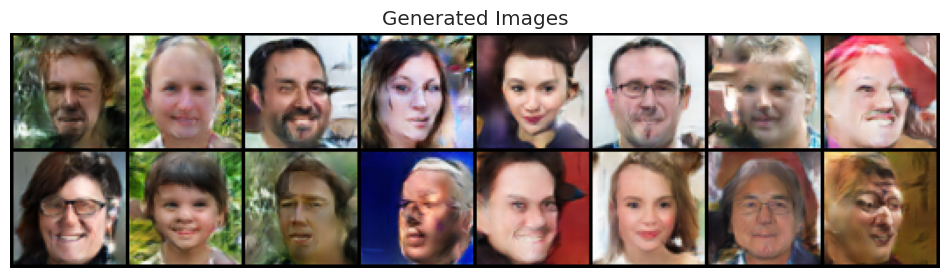

Epoch [12/25], loss_g: 3.2325, loss_d: 0.4684, real_score: 0.8787, fake_score: 0.1210


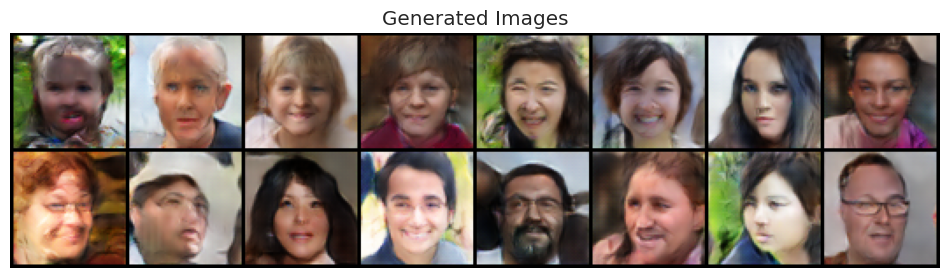

Epoch [13/25], loss_g: 3.2398, loss_d: 0.4905, real_score: 0.8775, fake_score: 0.1221


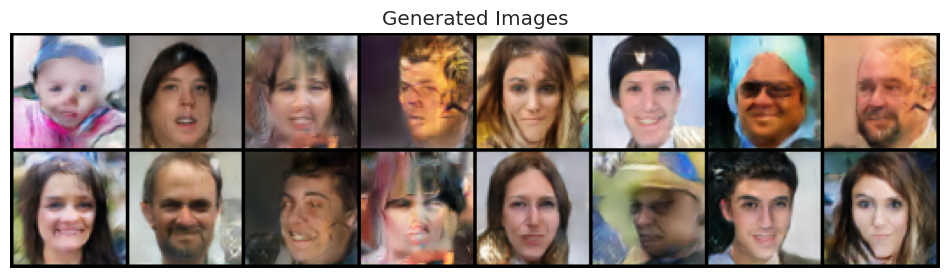

Epoch [14/25], loss_g: 3.2676, loss_d: 0.4953, real_score: 0.8776, fake_score: 0.1226


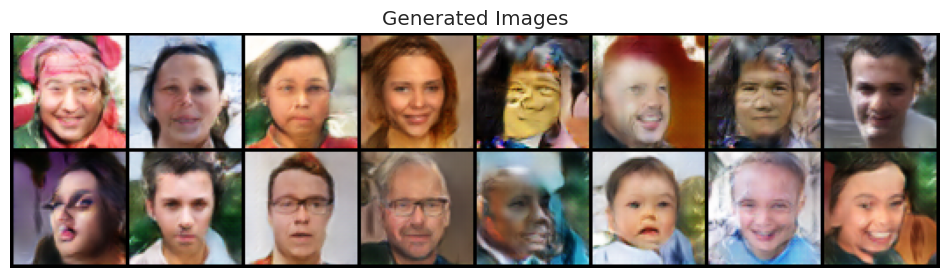

Epoch [15/25], loss_g: 3.2562, loss_d: 0.4755, real_score: 0.8803, fake_score: 0.1193


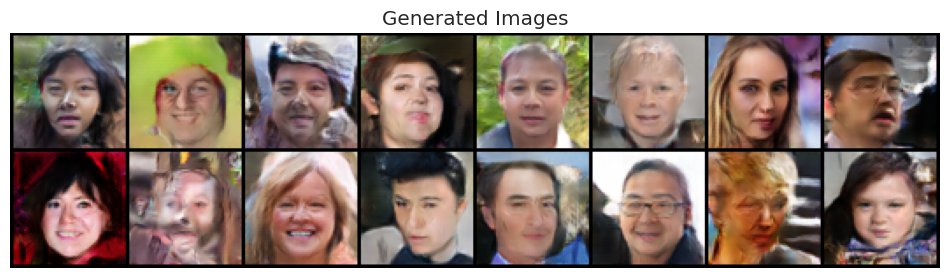

Epoch [16/25], loss_g: 3.3070, loss_d: 0.5072, real_score: 0.8738, fake_score: 0.1266


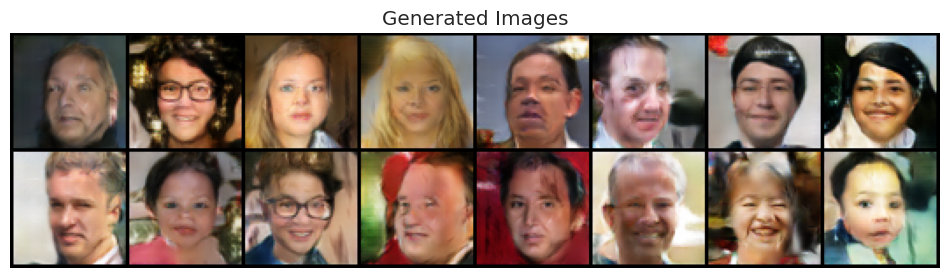

Epoch [17/25], loss_g: 3.2554, loss_d: 0.4876, real_score: 0.8774, fake_score: 0.1220


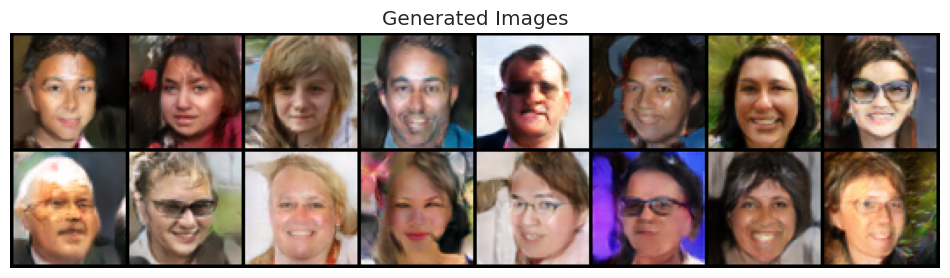

Epoch [18/25], loss_g: 3.3011, loss_d: 0.4613, real_score: 0.8839, fake_score: 0.1163


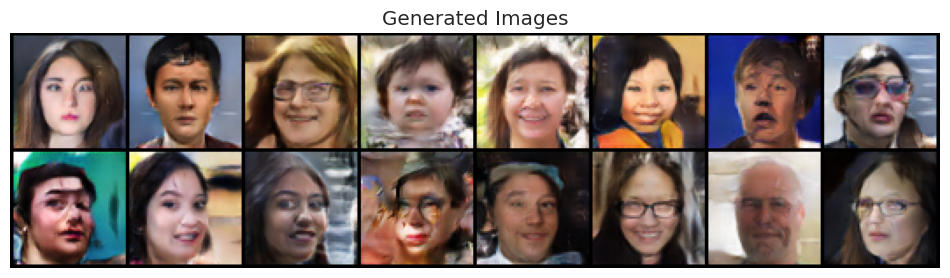

Epoch [19/25], loss_g: 3.3119, loss_d: 0.5067, real_score: 0.8778, fake_score: 0.1226


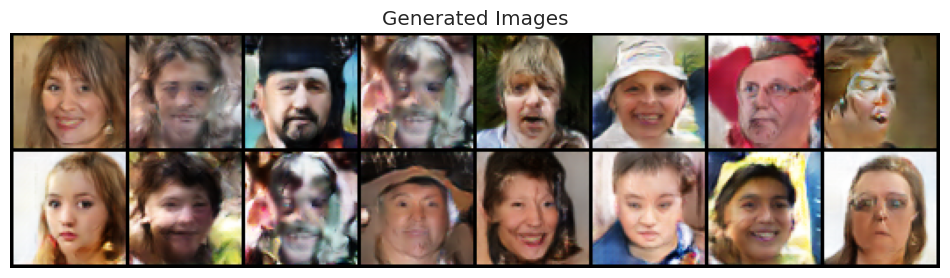

Epoch [20/25], loss_g: 3.3051, loss_d: 0.5123, real_score: 0.8767, fake_score: 0.1234


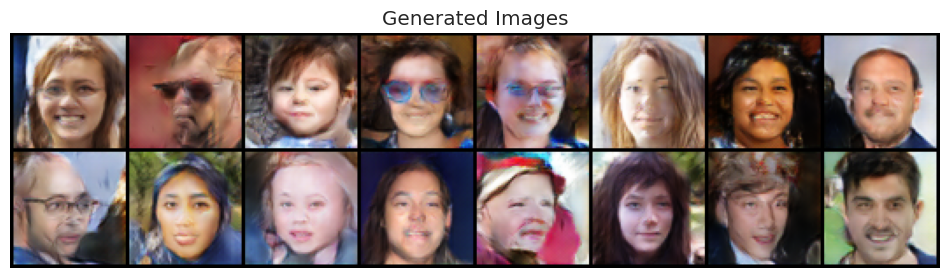

Epoch [21/25], loss_g: 3.3576, loss_d: 0.4714, real_score: 0.8820, fake_score: 0.1177


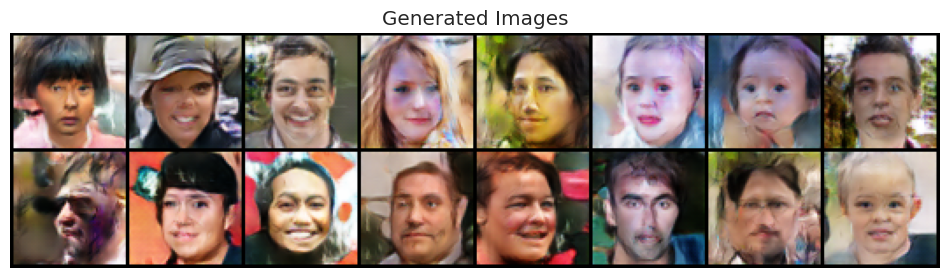

Epoch [22/25], loss_g: 3.3316, loss_d: 0.4685, real_score: 0.8840, fake_score: 0.1159


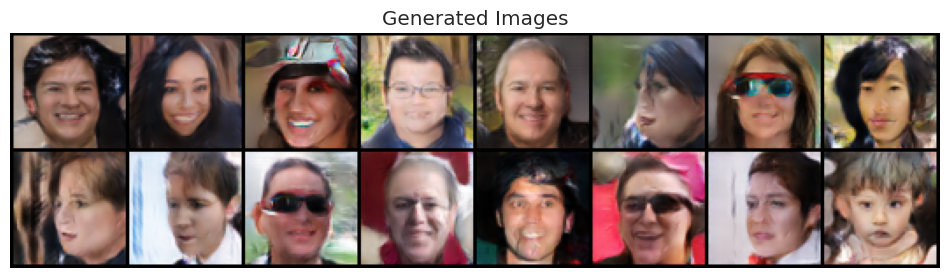

Epoch [23/25], loss_g: 3.3638, loss_d: 0.4828, real_score: 0.8810, fake_score: 0.1191


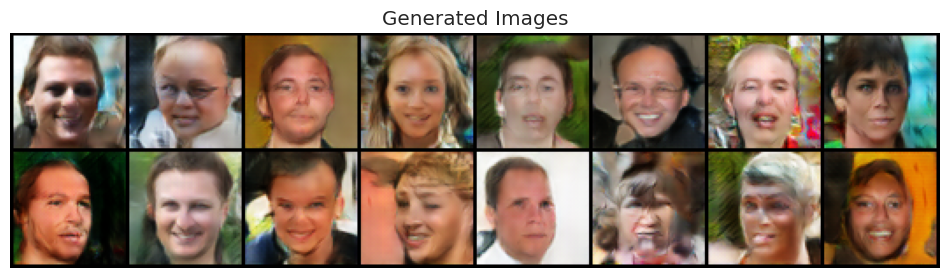

Epoch [24/25], loss_g: 3.4426, loss_d: 0.4869, real_score: 0.8829, fake_score: 0.1171


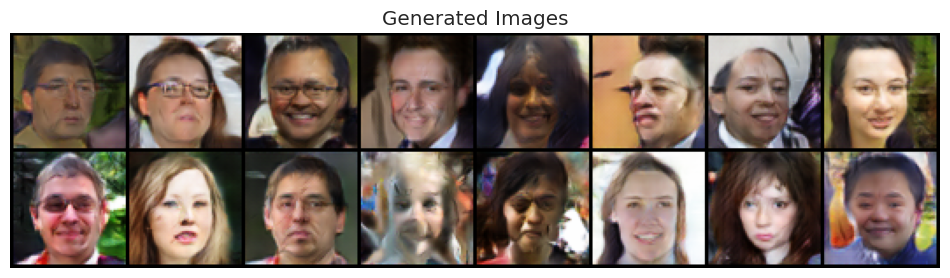

Epoch [25/25], loss_g: 3.3984, loss_d: 0.4451, real_score: 0.8904, fake_score: 0.1091


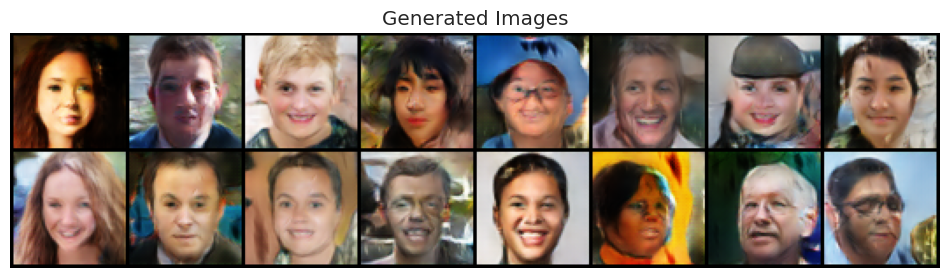

In [19]:
lr = 0.0005
losses_g, losses_d, real_scores, fake_scores = fit(model, criterion, 25, lr)

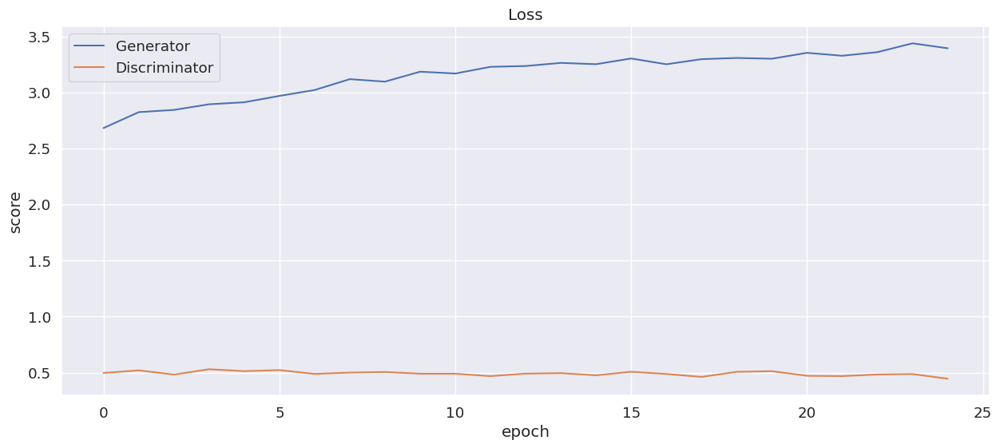

In [20]:
plt.figure(figsize=(15, 6))

plt.plot(losses_g, '-')
plt.plot(losses_d, '-')
plt.xlabel('epoch')
plt.ylabel('score')
plt.legend(['Generator', 'Discriminator'])
plt.title('Loss');

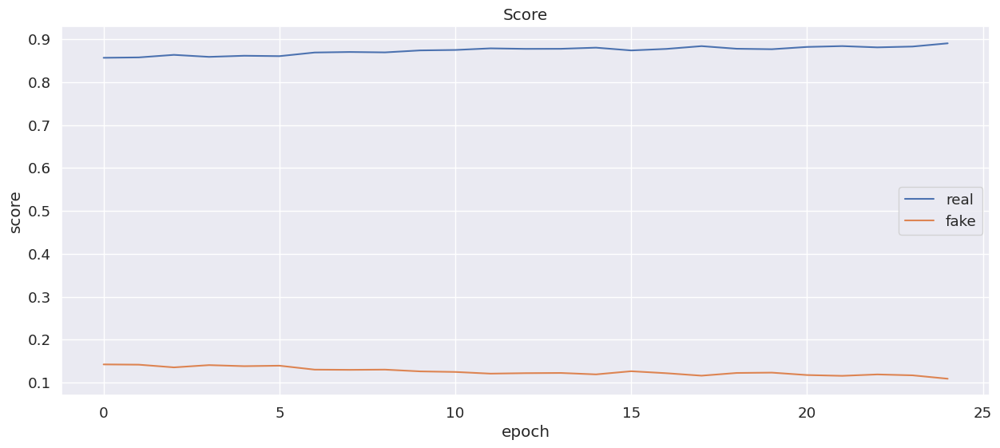

In [21]:
plt.figure(figsize=(15, 6))

plt.plot(real_scores, '-')
plt.plot(fake_scores, '-')
plt.xlabel('epoch')
plt.ylabel('score')
plt.legend(['real', 'fake'])
plt.title('Score');

  0%|          | 0/25 [00:00<?, ?it/s]

Epoch [1/25], loss_g: 3.4202, loss_d: 0.3406, real_score: 0.9259, fake_score: 0.0743


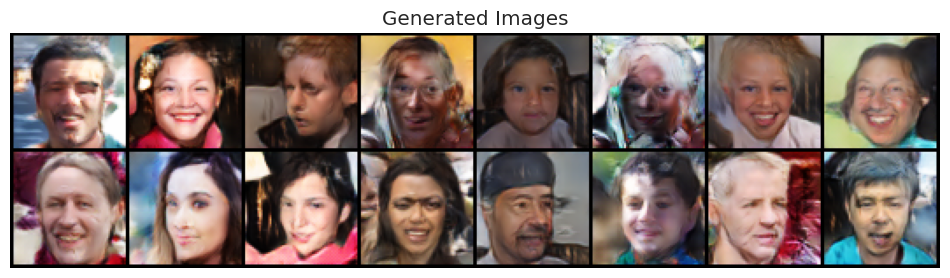

Epoch [2/25], loss_g: 3.4344, loss_d: 0.3263, real_score: 0.9304, fake_score: 0.0693


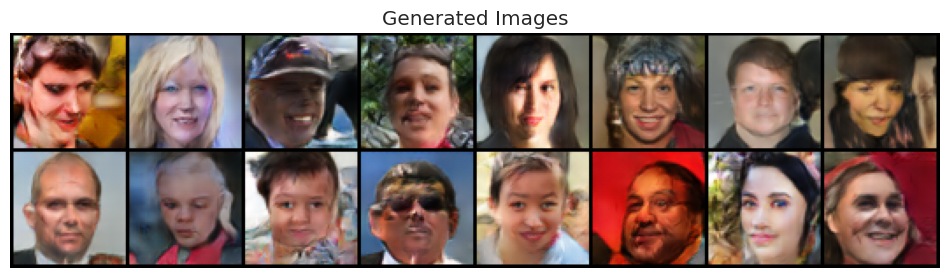

Epoch [3/25], loss_g: 3.4829, loss_d: 0.3378, real_score: 0.9285, fake_score: 0.0710


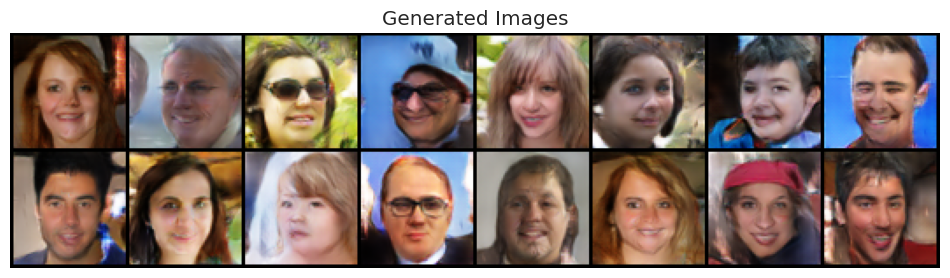

Epoch [4/25], loss_g: 3.5204, loss_d: 0.3305, real_score: 0.9314, fake_score: 0.0687


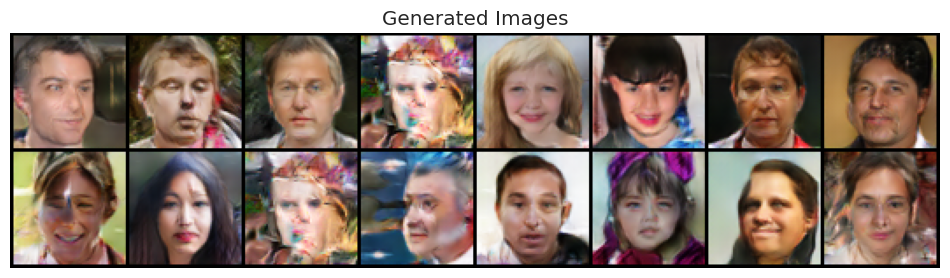

Epoch [5/25], loss_g: 3.5650, loss_d: 0.3319, real_score: 0.9312, fake_score: 0.0688


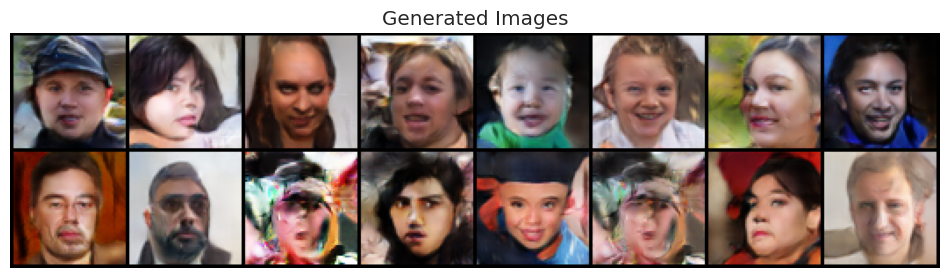

Epoch [6/25], loss_g: 3.5893, loss_d: 0.3323, real_score: 0.9318, fake_score: 0.0679


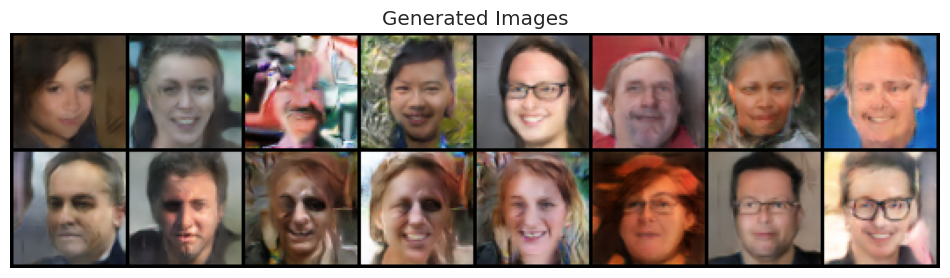

Epoch [7/25], loss_g: 3.5724, loss_d: 0.3539, real_score: 0.9274, fake_score: 0.0729


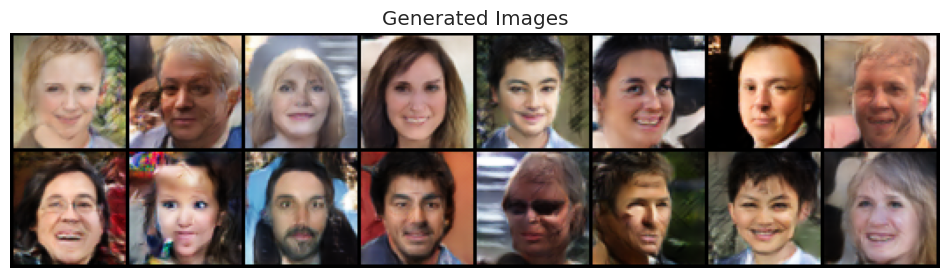

Epoch [8/25], loss_g: 3.5461, loss_d: 0.3276, real_score: 0.9318, fake_score: 0.0680


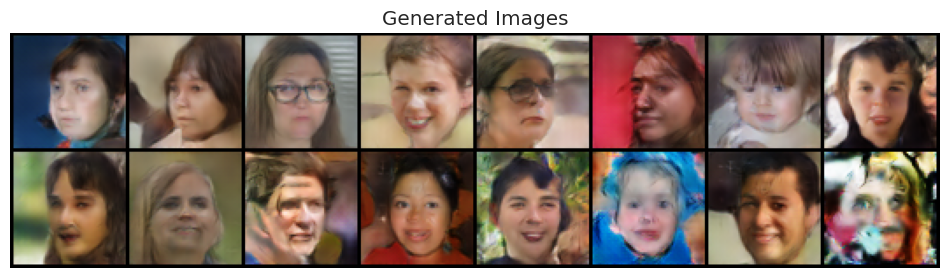

Epoch [9/25], loss_g: 3.5481, loss_d: 0.3413, real_score: 0.9297, fake_score: 0.0702


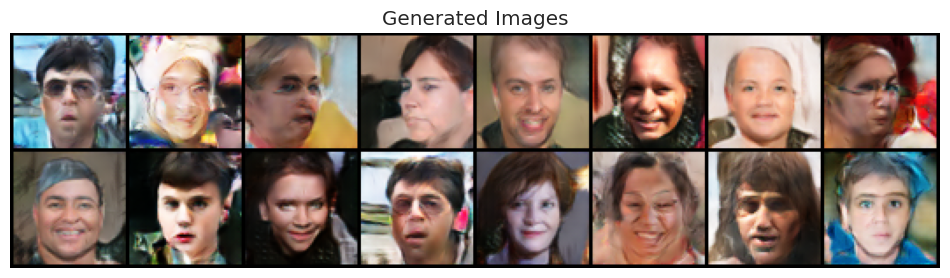

Epoch [10/25], loss_g: 3.5616, loss_d: 0.3487, real_score: 0.9274, fake_score: 0.0728


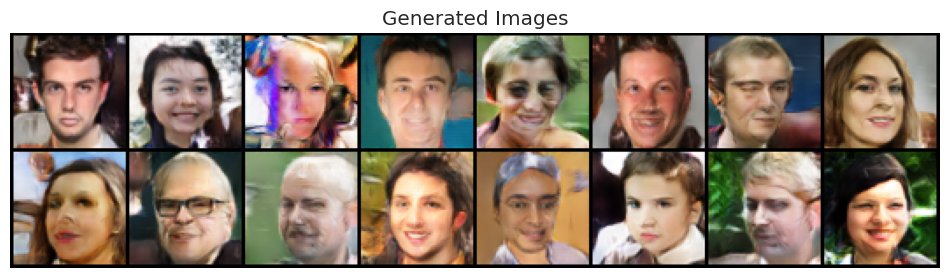

Epoch [11/25], loss_g: 3.5443, loss_d: 0.3311, real_score: 0.9313, fake_score: 0.0686


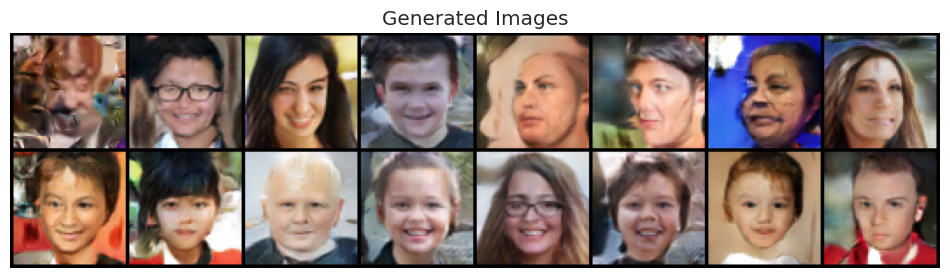

Epoch [12/25], loss_g: 3.6508, loss_d: 0.3410, real_score: 0.9299, fake_score: 0.0699


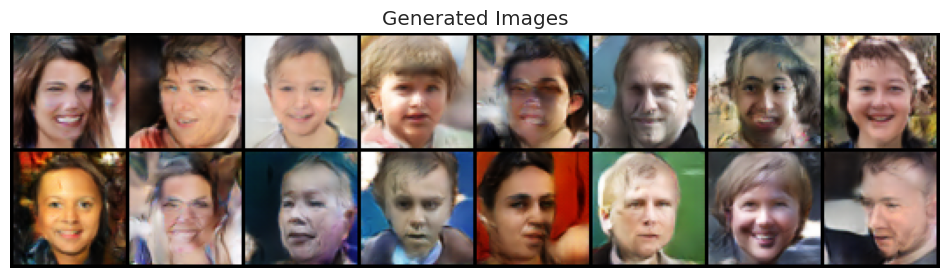

Epoch [13/25], loss_g: 3.6476, loss_d: 0.3420, real_score: 0.9301, fake_score: 0.0701


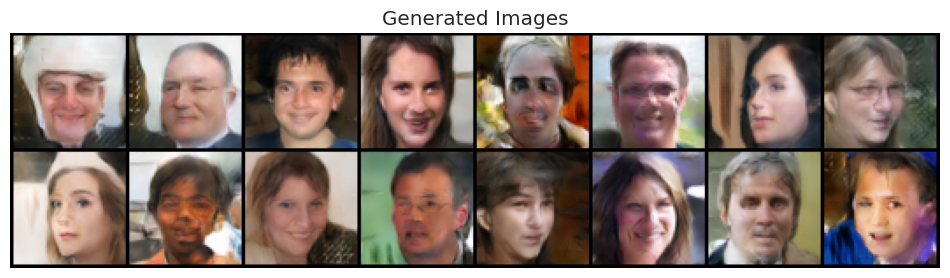

Epoch [14/25], loss_g: 3.6316, loss_d: 0.3616, real_score: 0.9264, fake_score: 0.0739


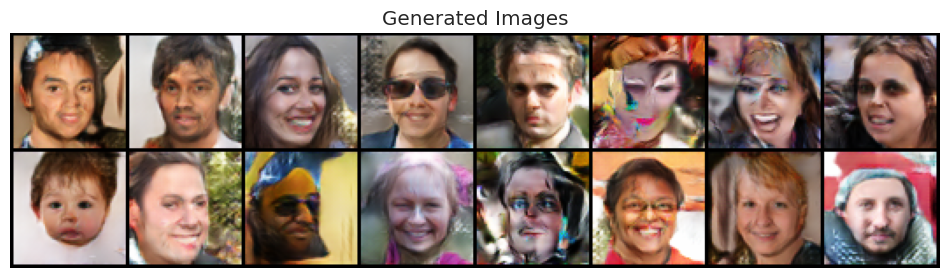

Epoch [15/25], loss_g: 3.6437, loss_d: 0.3329, real_score: 0.9318, fake_score: 0.0680


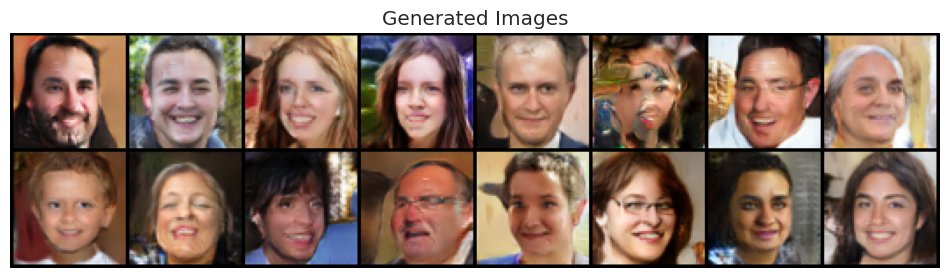

Epoch [16/25], loss_g: 3.6333, loss_d: 0.3464, real_score: 0.9287, fake_score: 0.0711


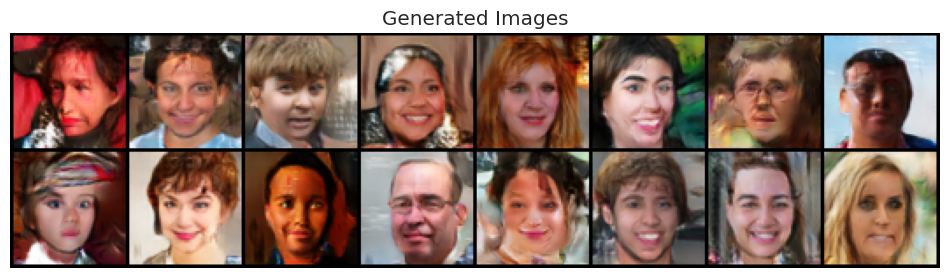

Epoch [17/25], loss_g: 3.6734, loss_d: 0.3344, real_score: 0.9324, fake_score: 0.0676


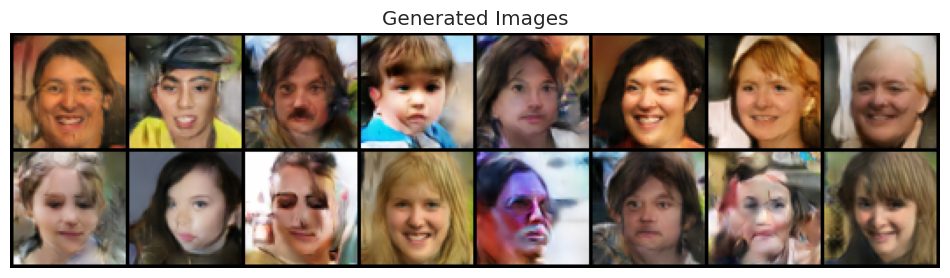

Epoch [18/25], loss_g: 3.6847, loss_d: 0.3405, real_score: 0.9310, fake_score: 0.0689


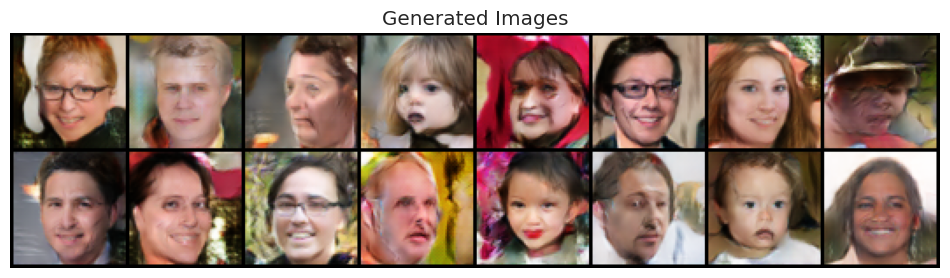

Epoch [19/25], loss_g: 3.6030, loss_d: 0.3488, real_score: 0.9295, fake_score: 0.0705


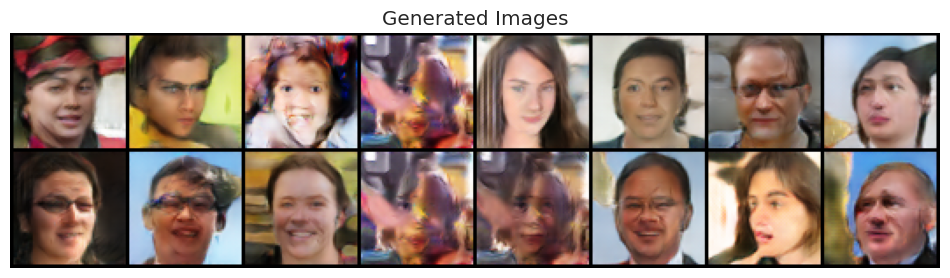

Epoch [20/25], loss_g: 3.6839, loss_d: 0.3432, real_score: 0.9305, fake_score: 0.0694


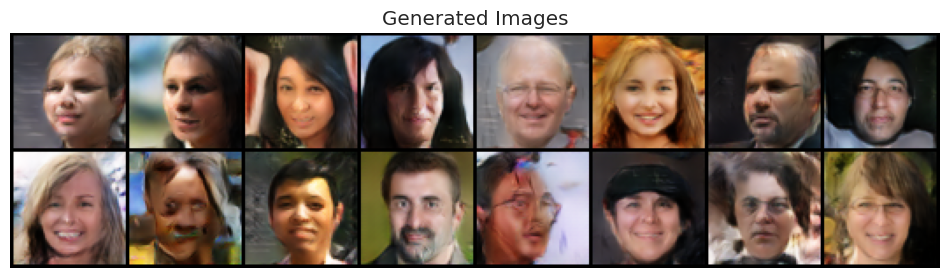

Epoch [21/25], loss_g: 3.6742, loss_d: 0.3449, real_score: 0.9302, fake_score: 0.0697


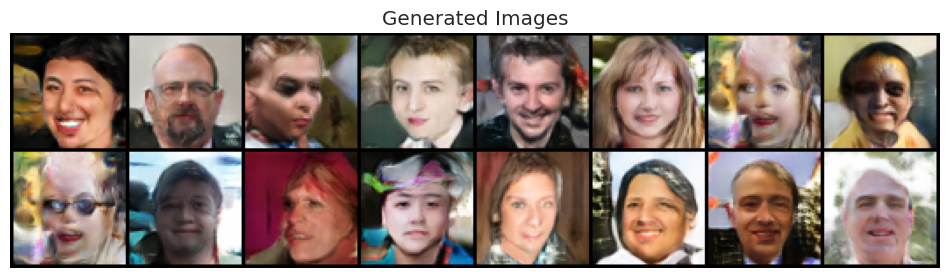

Epoch [22/25], loss_g: 3.7040, loss_d: 0.3359, real_score: 0.9328, fake_score: 0.0672


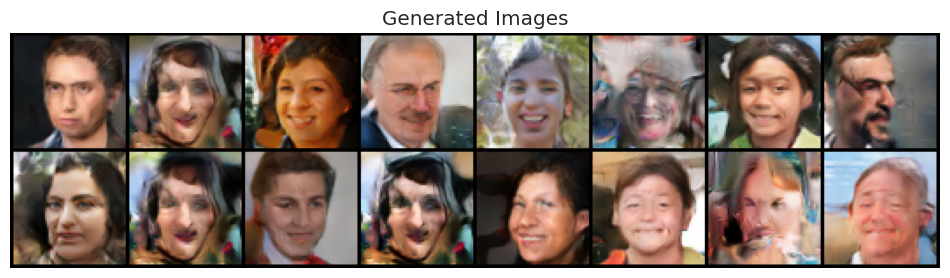

Epoch [23/25], loss_g: 3.7227, loss_d: 0.3522, real_score: 0.9315, fake_score: 0.0685


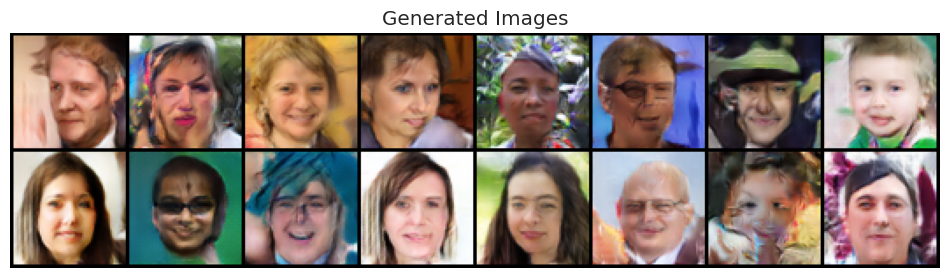

Epoch [24/25], loss_g: 3.6867, loss_d: 0.3405, real_score: 0.9314, fake_score: 0.0685


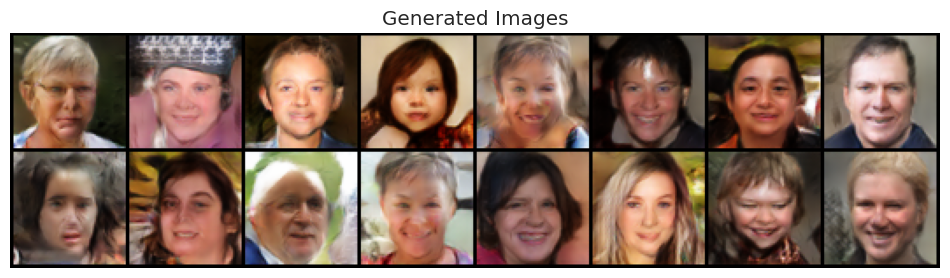

Epoch [25/25], loss_g: 3.6869, loss_d: 0.3465, real_score: 0.9297, fake_score: 0.0703


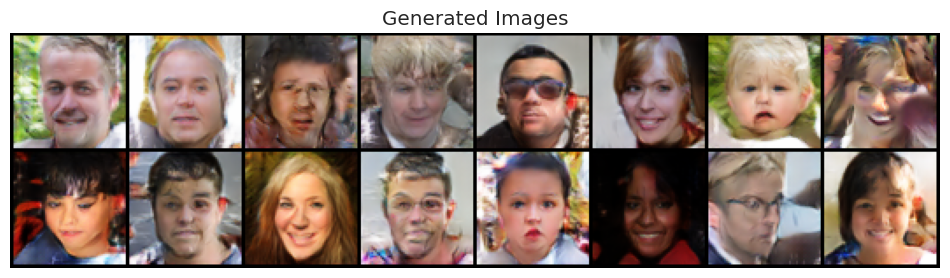

In [22]:
lr = 0.0002
losses_g, losses_d, real_scores, fake_scores = fit(model, criterion, 25, lr)

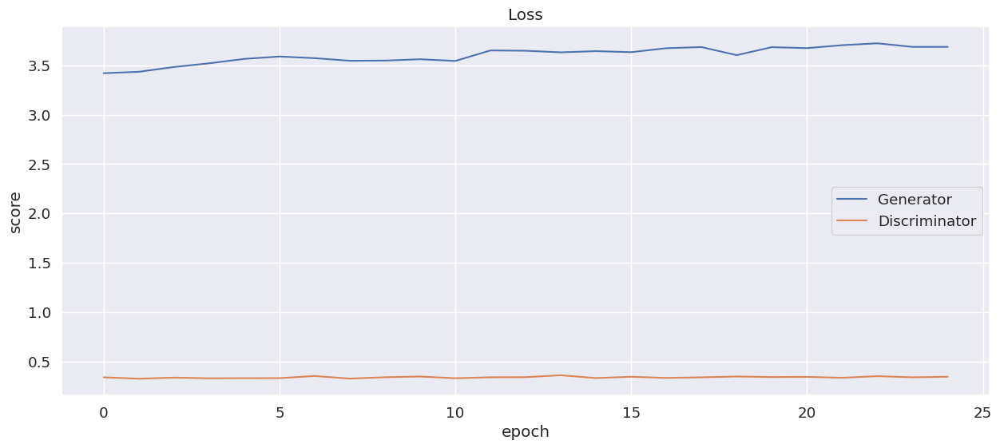

In [23]:
plt.figure(figsize=(15, 6))

plt.plot(losses_g, '-')
plt.plot(losses_d, '-')
plt.xlabel('epoch')
plt.ylabel('score')
plt.legend(['Generator', 'Discriminator'])
plt.title('Loss');

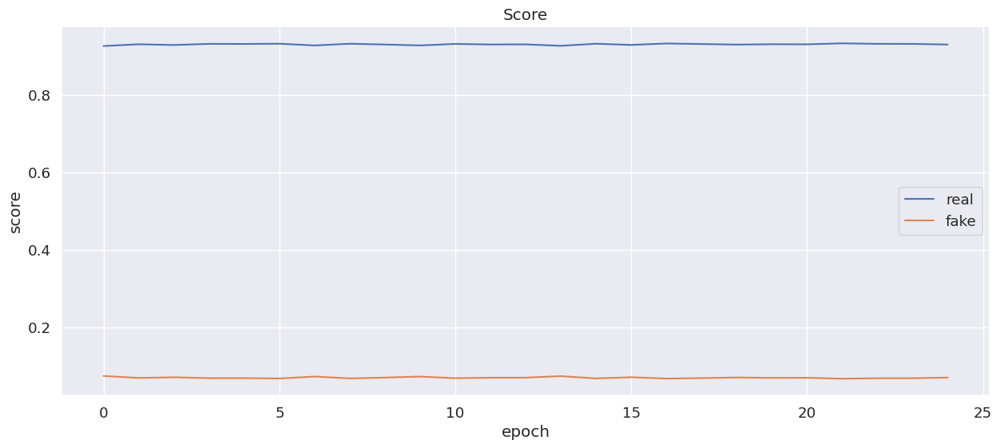

In [24]:
plt.figure(figsize=(15, 6))

plt.plot(real_scores, '-')
plt.plot(fake_scores, '-')
plt.xlabel('epoch')
plt.ylabel('score')
plt.legend(['real', 'fake'])
plt.title('Score');

## 3.Генерация изображений и оценка качества

In [27]:
n_images = 2000

fixed_latent = torch.randn(n_images, latent_size, 1, 1, device=device)
fake_images = model["generator"].to(device)(fixed_latent)
real_images = next(iter(get_dataloader(image_size, n_images)))[0]

In [28]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
from sklearn.model_selection import LeaveOneOut
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

zeros = torch.zeros(n_images, 1, device='cpu')
ones = torch.ones(n_images, 1, device='cpu')

X = torch.cat((fake_images.cpu(), real_images.cpu())).detach().numpy().reshape(-1, 3*64*64)
y = torch.cat((zeros, ones)).detach().numpy()

knc = KNeighborsClassifier(n_neighbors=1)
loo = LeaveOneOut()

accuracy_score_history = []
predictions = []
targets = []
for train_index, test_index in tqdm(loo.split(X)):
    X_train, X_test = X[train_index], X[test_index]
    y_train, y_test = y[train_index], y[test_index]
    knc.fit(X_train, np.ravel(y_train))
    pred = knc.predict(X_test)
    accuracy_score_history.append(accuracy_score(pred, y_test))
    predictions.append(pred)
    targets.append(y_test)

0it [00:00, ?it/s]

Mean accuracy = 0.609


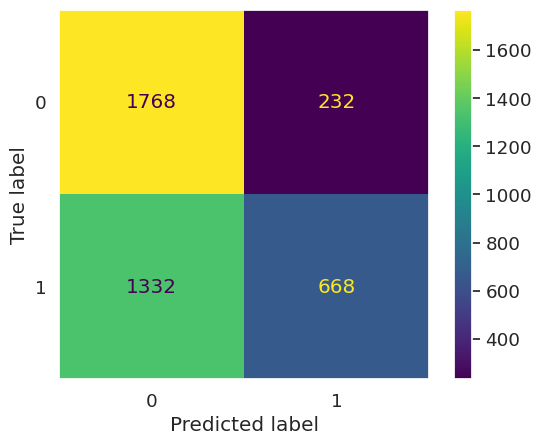

In [29]:
print('Mean accuracy =', np.mean(accuracy_score_history))

cm =  confusion_matrix([t.item() for t in targets],
                       [p.item() for p in predictions])
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.grid(False)
plt.show()

Accuracy стала ближе к 0.5, что говорит о повышении качества модели. Видно, что теперь модель научилась обманывать дискриминатор чаще.

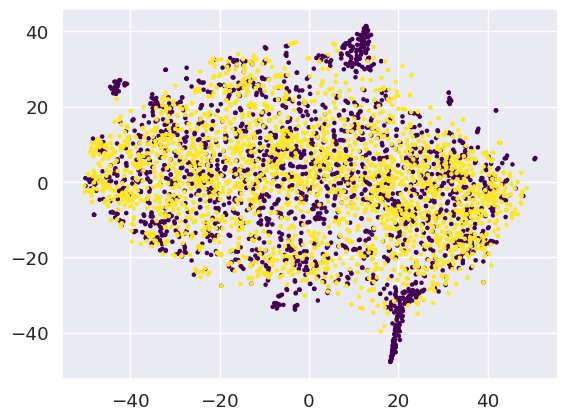

In [30]:
import numpy as np
from sklearn.manifold import TSNE
X_embedded = TSNE(n_components=2, learning_rate='auto',
                  init='random').fit_transform(X)


x1, x2 = zip(*X_embedded)
plt.scatter(x1, x2, c=y, s=5, cmap='viridis')

Как мы видим, качетсво модели стало гораздо лучше. Видно, что модель немного переобучилась, на последнем графике видно, что распредления примерно совпадают, но есть места, где сильно выделяются сгенерированные изображения (есть "выбросы", места, где большое скопление только фиолетовых точек). Также слегка упало качество сгенерированных изображений под конец обучения (стоило делать меньше эпох обучения, или подкрутить гиперпараметры). 

В любом случае, на этом датасете результат гораздо лучше. Из 2000 сгенерированных картинок 232 смогли обмануть классификатор, а точки на последнем графике почти полностью перемешаны.